In [1]:
import spacy
from spacy.lang.en import English

text = open('data/Tolkien J.. The Lord of the Rings.txt').read()

spacy_nlp = spacy.load('en_core_web_sm')

In [14]:
def get_person_entities(text):
    ents = set()
    doc = spacy_nlp(text.strip())
    for ent in doc.ents:
        if (ent.label_ == "PERSON"):
            ents.add(ent.text)
    
    ents_clear = set()
    
    for e in ents:
        if "the " not in e.lower():
            ents_clear.add(e)
    
    return ents_clear

In [15]:
ents = get_person_entities(text)
print(ents, len(ents))

{'keen grey', 'Sam Gamgee', 'L&#243;rien', 'Good-bye', 'Arwen', 'Proudfoot', 'Dol Guldur', 'Rory Brandybuck', 'Ben-adar', 'Amon Lhaw', 'Nay', 'Twofoot', 'Folco Boffin', 'Ted Sandyman', 'Hal', 'Mugworts', 'Grubbs', 'Troll', 'Said Tom', 'bent', 'Will Haldir', 'Morgul Vale', 'Glorfindel', 'Fang', 'Sirannon', 'Esgalduin', 'Moon', 'Harad', 'Vulgar', 'Westernesse', 'Mordor', 'Tom', 'Celebrimbor', 'Barley', 'Naur dan', 'Michel Delving', 'BUTTERBUR', 'Mugwort', 'Gore', 'Boffin', 'Kin', 'Elbereth Gilthoniel', 'Gil-galad', 'woollen hose', 'Barrow', 'Enemy', 'moon', 'Clip-clop', 'Merry quietly', 'Farmer Maggot', 'Bilbo', 'Lor', 'Merry to Strider', 'Midsummer', 'Elbereth', 'Eastfar', 'Butterbur', 'Buckland', 'Isildur Elendil’s', 'Ferry', 'Gildor', 'Sancho Proudfoot', 'Sancho', 'Maegovannen', 'Rauros', 'Caras Galadhon', 'Southerner', 'Gimli', 'grey Willow-man', 'Thorin Oakenshield', 'Harry', 'Ithilien', 'Parth Galen', 'Fair', 'nut', 'Grip', 'Lhaw', 'Bill square', 'Havens', 'Snow', 'Thranduil', 'Bra

In [16]:
def get_sentences(text):
    nlp = English()
    nlp.add_pipe(nlp.create_pipe('sentencizer'))
    document = nlp(text)
    return [sentence.string.strip() for sentence in document.sents]

def tokenize(sentence):
    tokens = spacy_nlp(sentence)
    return(tokens)

In [24]:
def get_entity_traits(entities, text):
    sents = get_sentences(text)
    ent_traits = {}
    
    trait_deps = ["adj", "agent", "amod"]
    
    for e in entities:
        traits = set()
        
        for sent in sents:
            if e.lower() in sent.lower():
                for token in tokenize(sent):
                    if token.dep_ in trait_deps:
                        traits.add(token.text.lower())
                        
                ent_traits[e] = traits.copy()
    
    return ent_traits

In [27]:
entity_traits = get_entity_traits(ents, text)

In [60]:
print(entity_traits)

{'keen grey': {'pale', 'dark', 'shaggy', 'keen'}, 'Sam Gamgee': {'own', 'old', 'youngest', 'by', 'good', 'only', 'curly'}, 'L&#243;rien': {'pale', 'fair', 'secret', 'other', 'clear', 'last', 'least', 'outer', 'golden', 'long', 'bright', 'living', 'enchanted', 'little', 'first', 'great', 'slender', 'own', 'cunning', 'forgotten', 'flowing', 'waking', 'by', 'distant', 'gentle', 'ancient'}, 'Good-bye': {'good', 'next', 'dear', 'painful'}, 'Arwen': {'due'}, 'Proudfoot': {'larger', 'dear', 'dead', 'old', 'several', 'deep', 'young'}, 'Dol Guldur': {'evil', 'hidden', 'many', 'alone', 'older'}, 'Rory Brandybuck': {'much', 'old'}, 'Ben-adar': set(), 'Amon Lhaw': {'southern'}, 'Nay': {'first', 'single'}, 'Twofoot': {'next', 'right', 'wrong'}, 'Folco Boffin': {'special'}, 'Ted Sandyman': {'cutting', 'brown'}, 'Hal': {'hoof', 'old', 'arch', 'hard', 'brief', 'cold', 'heavy', 'generous', 'more', 'hot', 'peculiar', 'only', 'east', 'mighty', 'pillared', 'lane', 'green', 'ancient', 'strong', 'forged', '

In [63]:
import networkx as nx
import matplotlib.pyplot as plt

def display(ent_traits):
    
    for ent in ent_traits:
        
        G = nx.Graph()
        G.add_node(ent)
        for trait in ent_traits[ent]:
            G.add_node(trait)
            G.add_edge(ent, trait)
        
        colors = []
        for i, node in enumerate(G.nodes):
            if i > 0:
                colors.append('skyblue')
            else:
                colors.append('pink')
    
        G.remove_nodes_from(list(nx.isolates(G)))
        pos = nx.spring_layout(G)
        plt.figure(figsize=(10,10))
        nx.draw(G, pos, edge_color='black', width=.5, linewidths=.5, node_size=500, node_color=colors, alpha=0.9, with_labels=True)
        plt.axis('off')
        plt.show()

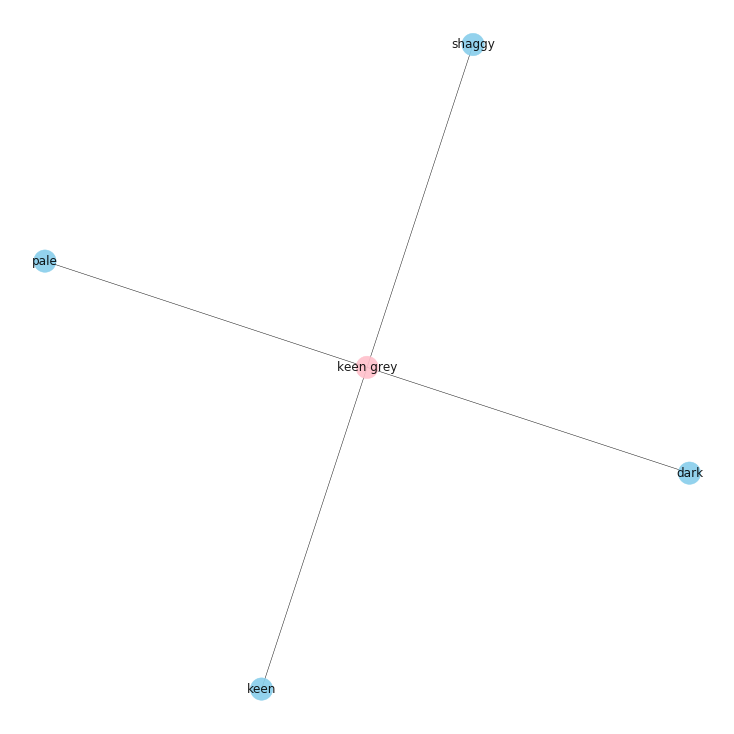

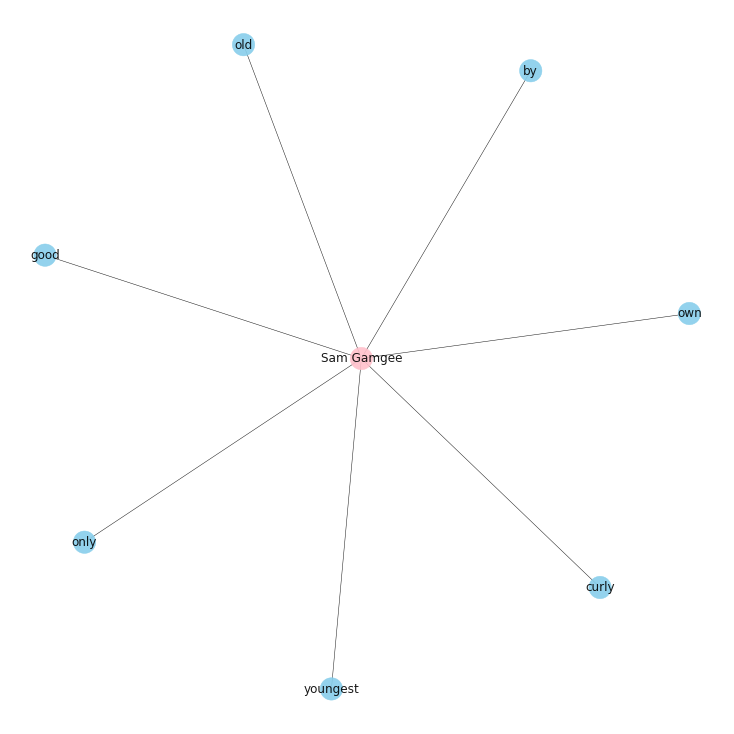

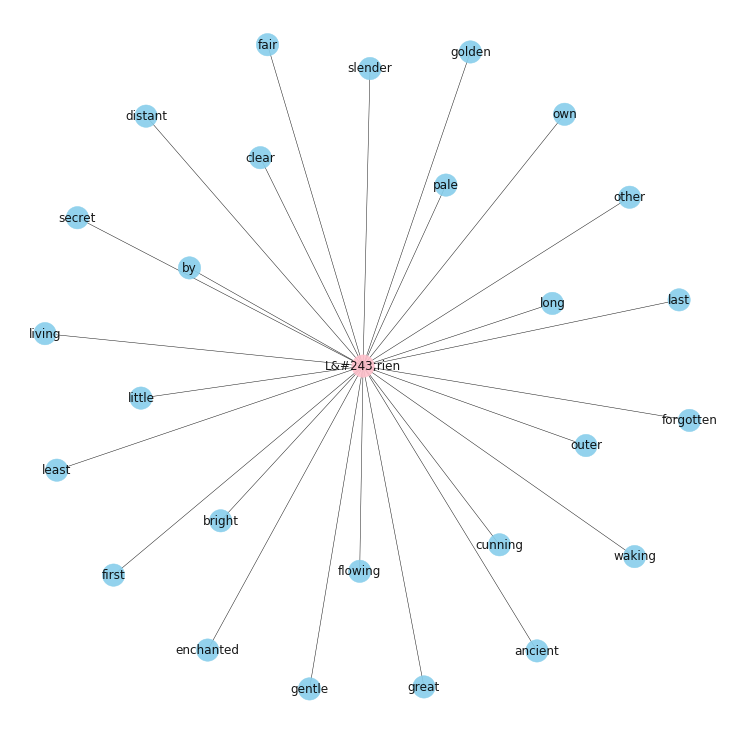

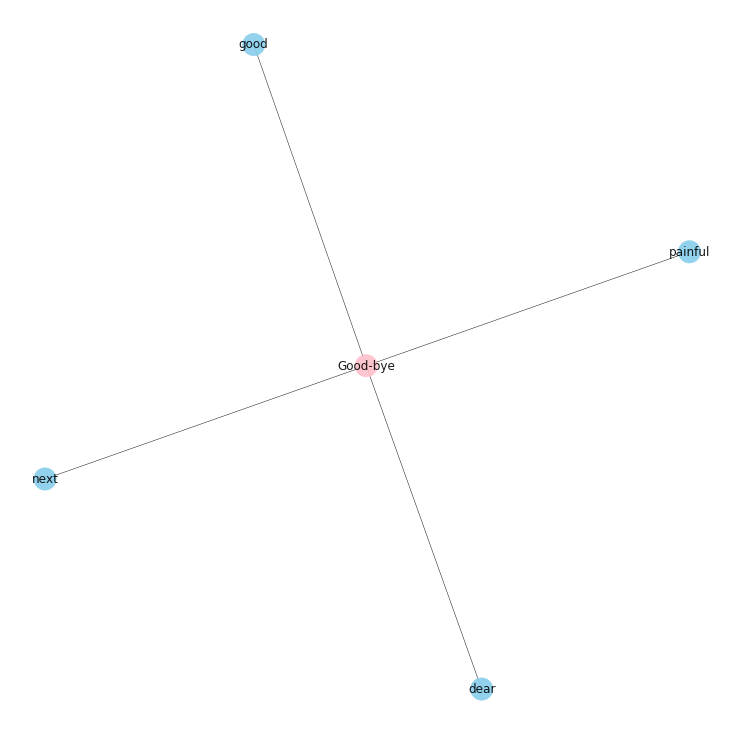

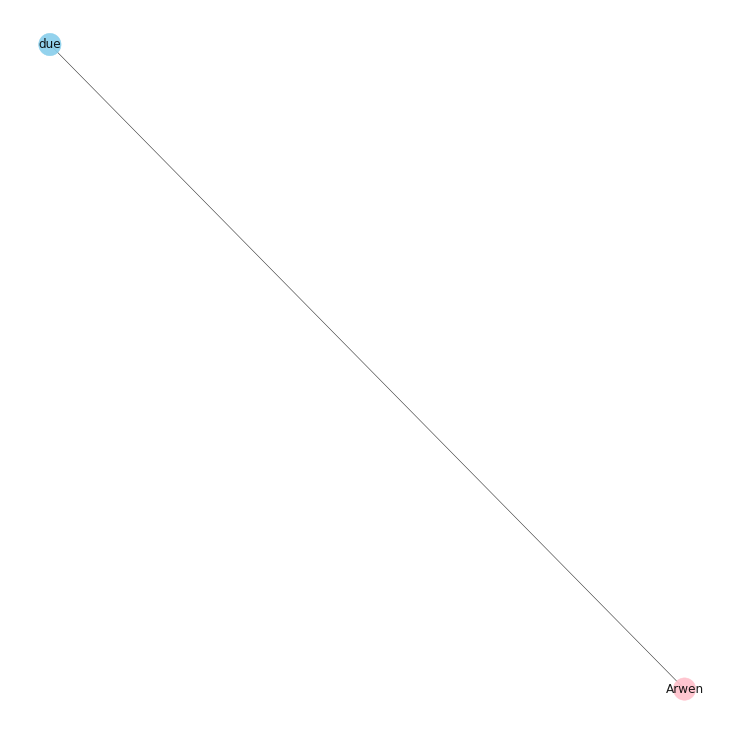

...

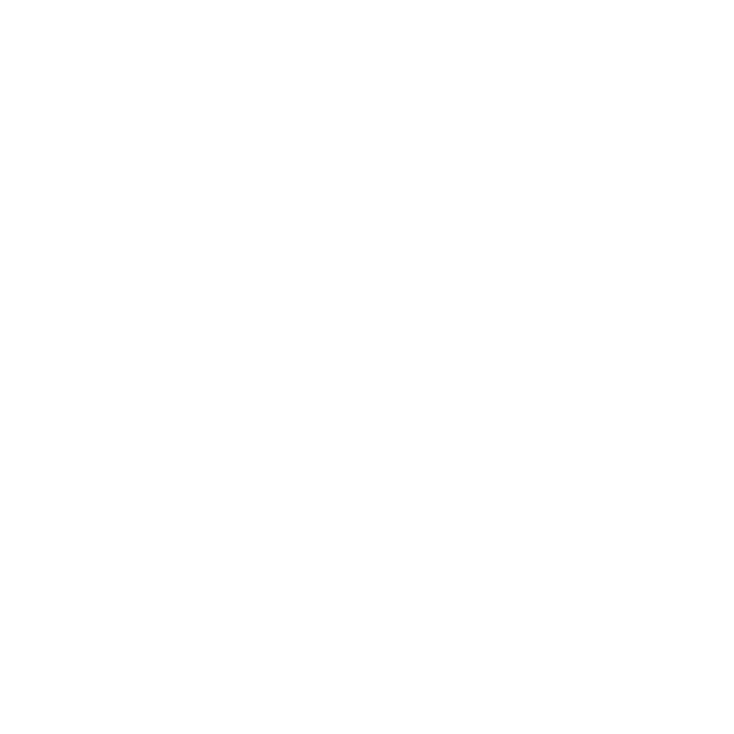

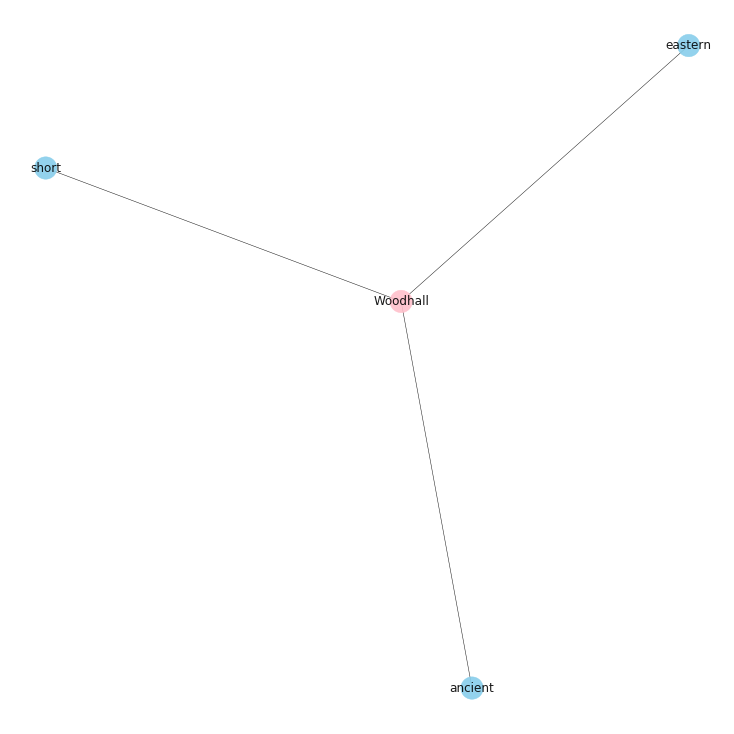

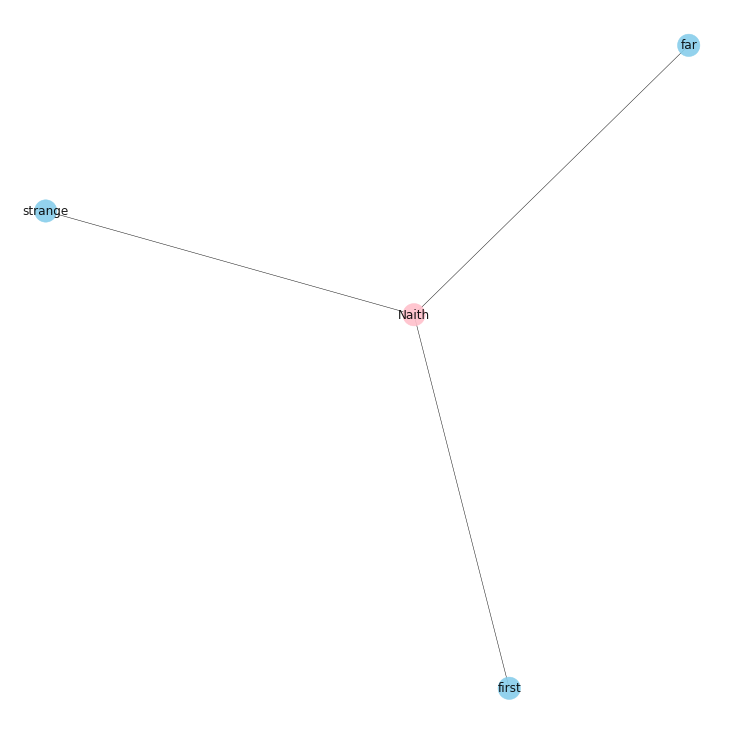

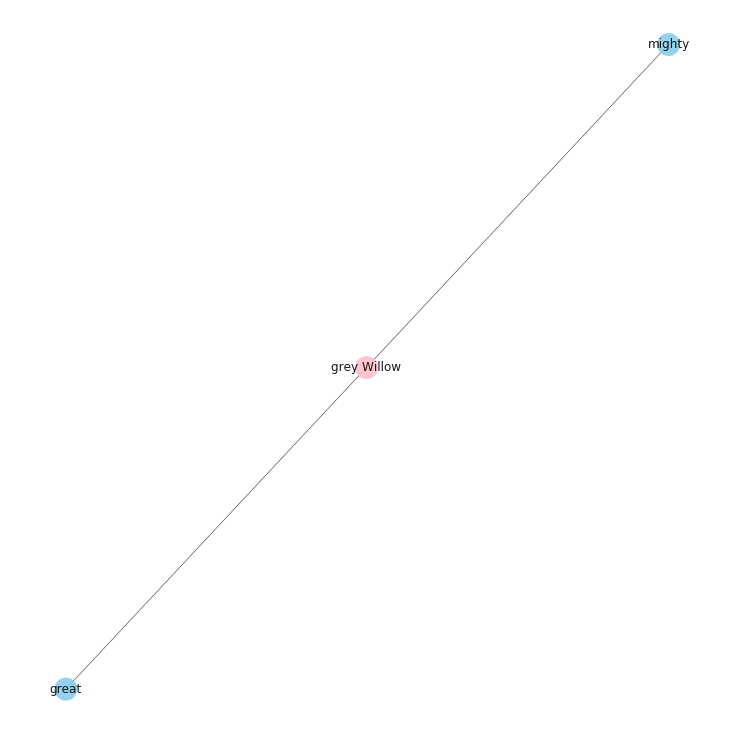

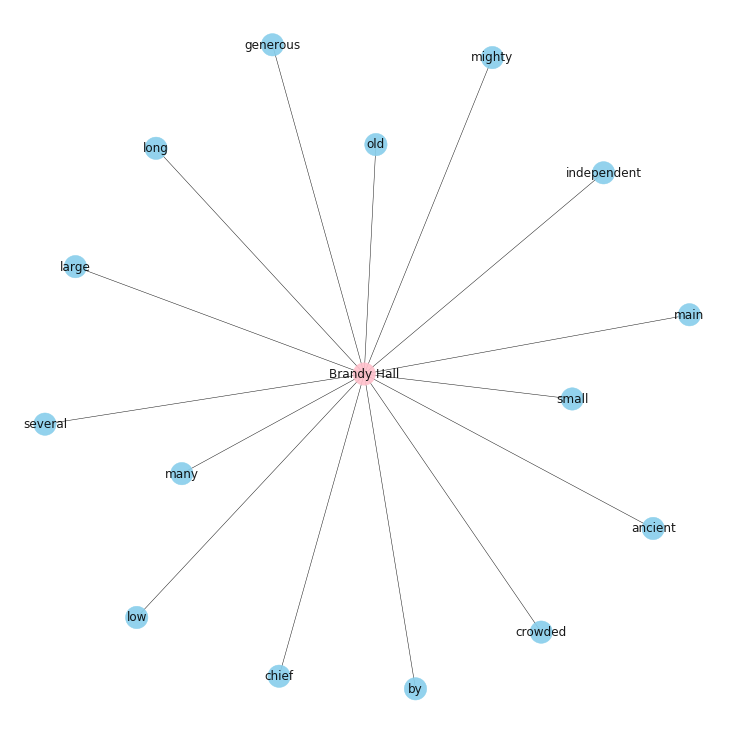

In [64]:
display(entity_traits)